In [1]:
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive
%cd /mydrive/Tensorflow-Models

Mounted at /content/gdrive
/content/gdrive/.shortcut-targets-by-id/1oP3ewZgiatY88SU5esvVcTCqbdfjYu1d/Tensorflow-Models


In [ ]:
import os
import numpy as np
from glob import glob
import cv2
from scipy.io import loadmat
import matplotlib.pyplot as plt

import keras
import tensorflow as tf
from tensorflow import image as tf_image
from tensorflow import data as tf_data
from tensorflow import io as tf_io

In [3]:
import os
import json

def count_images(image_dir, exts={".jpg", ".jpeg", ".png", ".bmp", ".webp"}):
    image_count = 0
    for filename in os.listdir(image_dir):
        if os.path.splitext(filename.lower())[1] in exts:
            image_count += 1
    print(f"Total images: {image_count}")

count_images("/content/gdrive/MyDrive/Pytorch-Models/datasets/soybean_weeds/train/images")
count_images("/content/gdrive/MyDrive/Pytorch-Models/datasets/soybean_weeds/train/masks")
count_images("/content/gdrive/MyDrive/Pytorch-Models/datasets/soybean_weeds/valid/images")
count_images("/content/gdrive/MyDrive/Pytorch-Models/datasets/soybean_weeds/valid/masks")

Total images: 1398
Total images: 1398
Total images: 350
Total images: 350


In [4]:
IMAGE_SIZE = 512
NUM_CLASSES = 4
# Hyperparameters
img_size = (IMAGE_SIZE, IMAGE_SIZE)
batch_size = 16 # Reduced batch size to prevent OOM

import os
import random
import keras
import tensorflow as tf
from tensorflow import data as tf_data
from tensorflow import image as tf_image
from tensorflow import io as tf_io

# Paths
train_images_dir = "/content/gdrive/MyDrive/Pytorch-Models/datasets/soybean_weeds/train/images"
train_masks_dir  = "/content/gdrive/MyDrive/Pytorch-Models/datasets/soybean_weeds/train/masks"
valid_images_dir = "/content/gdrive/MyDrive/Pytorch-Models/datasets/soybean_weeds/valid/images"
valid_masks_dir  = "/content/gdrive/MyDrive/Pytorch-Models/datasets/soybean_weeds/valid/masks"

# Collect paths
def get_image_mask_paths(image_dir, mask_dir, img_exts={".jpg", ".jpeg", ".png"}):
    image_paths = sorted(
        [
            os.path.join(image_dir, fname)
            for fname in os.listdir(image_dir)
            if os.path.splitext(fname)[1].lower() in img_exts
        ]
    )
    mask_paths = sorted(
        [
            os.path.join(mask_dir, fname)
            for fname in os.listdir(mask_dir)
            if fname.endswith(".png") and not fname.startswith(".")
        ]
    )
    return image_paths, mask_paths

train_input_img_paths, train_target_img_paths = get_image_mask_paths(train_images_dir, train_masks_dir)
val_input_img_paths, val_target_img_paths     = get_image_mask_paths(valid_images_dir, valid_masks_dir)

print(f"Train samples: {len(train_input_img_paths)}")
print(f"Valid samples: {len(val_input_img_paths)}")

# Dataset loader
def get_dataset(batch_size, img_size, input_img_paths, target_img_paths, max_dataset_len=None):
    """Returns a TF Dataset."""

    def load_img_masks(input_img_path, target_img_path):
        input_img = tf_io.read_file(input_img_path)
        input_img = tf_io.decode_image(input_img, channels=3, expand_animations=False)
        input_img = tf_image.resize(input_img, img_size)
        input_img = tf_image.convert_image_dtype(input_img, "float32")

        target_img = tf_io.read_file(target_img_path)
        target_img = tf_io.decode_image(target_img, channels=1, expand_animations=False)
        target_img = tf_image.resize(target_img, img_size, method="nearest")
        # keep masks as integer labels (do NOT normalize to float)
        target_img = tf.cast(target_img, tf.int32)

        return input_img, target_img

    if max_dataset_len:
        input_img_paths = input_img_paths[:max_dataset_len]
        target_img_paths = target_img_paths[:max_dataset_len]

    dataset = tf_data.Dataset.from_tensor_slices((list(input_img_paths), list(target_img_paths)))
    dataset = dataset.map(load_img_masks, num_parallel_calls=tf_data.AUTOTUNE)
    return dataset.batch(batch_size).prefetch(tf_data.AUTOTUNE)

# Build datasets
train_dataset = get_dataset(batch_size, img_size, train_input_img_paths, train_target_img_paths)
valid_dataset = get_dataset(batch_size, img_size, val_input_img_paths, val_target_img_paths)

Train samples: 1398
Valid samples: 350


In [5]:
for images, masks in train_dataset.take(1):
    print(images.shape, masks.shape, masks.dtype, masks.numpy().min(), masks.numpy().max())

(16, 512, 512, 3) (16, 512, 512, 1) <dtype: 'int32'> 0 3


In [ ]:
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from tensorflow.keras.layers import AveragePooling2D, GlobalAveragePooling2D, UpSampling2D, Reshape, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.applications import ResNet50
import tensorflow as tf

def SqueezeAndExcite(inputs, ratio=8):
    init = inputs
    filters = init.shape[-1]
    se_shape = (1, 1, filters)

    se = GlobalAveragePooling2D()(init)
    se = Reshape(se_shape)(se)
    se = Dense(filters // ratio, activation='relu', kernel_initializer='he_normal', use_bias=False)(se)
    se = Dense(filters, activation='sigmoid', kernel_initializer='he_normal', use_bias=False)(se)
    x = init * se
    return x

def ASPP(inputs):
    """ Image Pooling """
    shape = inputs.shape
    y1 = AveragePooling2D(pool_size=(shape[1], shape[2]))(inputs)
    y1 = Conv2D(256, 1, padding="same", use_bias=False)(y1)
    y1 = BatchNormalization()(y1)
    y1 = Activation("relu")(y1)
    y1 = UpSampling2D((shape[1], shape[2]), interpolation="bilinear")(y1)

    """ 1x1 conv """
    y2 = Conv2D(256, 1, padding="same", use_bias=False)(inputs)
    y2 = BatchNormalization()(y2)
    y2 = Activation("relu")(y2)

    """ 3x3 conv rate=6 """
    y3 = Conv2D(256, 3, padding="same", use_bias=False, dilation_rate=6)(inputs)
    y3 = BatchNormalization()(y3)
    y3 = Activation("relu")(y3)

    """ 3x3 conv rate=12 """
    y4 = Conv2D(256, 3, padding="same", use_bias=False, dilation_rate=12)(inputs)
    y4 = BatchNormalization()(y4)
    y4 = Activation("relu")(y4)

    """ 3x3 conv rate=18 """
    y5 = Conv2D(256, 3, padding="same", use_bias=False, dilation_rate=18)(inputs)
    y5 = BatchNormalization()(y5)
    y5 = Activation("relu")(y5)

    y = Concatenate()([y1, y2, y3, y4, y5])
    y = Conv2D(256, 1, padding="same", use_bias=False)(y)
    y = BatchNormalization()(y)
    y = Activation("relu")(y)

    return y

def deeplabv3_plus(shape, num_classes):
    """ Input """
    inputs = Input(shape)

    """ Encoder """
    encoder = ResNet50(weights="imagenet", include_top=False, input_tensor=inputs)

    image_features = encoder.get_layer("conv4_block6_out").output
    x_a = ASPP(image_features)
    x_a = UpSampling2D((4, 4), interpolation="bilinear")(x_a)

    x_b = encoder.get_layer("conv2_block2_out").output
    x_b = Conv2D(filters=48, kernel_size=1, padding='same', use_bias=False)(x_b)
    x_b = BatchNormalization()(x_b)
    x_b = Activation('relu')(x_b)

    x = Concatenate()([x_a, x_b])
    x = SqueezeAndExcite(x)

    x = Conv2D(filters=256, kernel_size=3, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters=256, kernel_size=3, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = SqueezeAndExcite(x)

    x = UpSampling2D((4, 4), interpolation="bilinear")(x)
    x = Conv2D(num_classes, 1)(x)
    x = Activation("softmax")(x)

    model = Model(inputs, x)
    return model

model = deeplabv3_plus((IMAGE_SIZE, IMAGE_SIZE, 3), num_classes=NUM_CLASSES)
model.summary()

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 512, 512,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 518, 518,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 256, 256,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 256, 256,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 256, 256,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 258, 258,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 128, 128,  │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 128, 128,  │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 128, 128,  │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 128, 128,  │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 128, 128,  │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 128, 128,  │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 128, 128,  │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 128, 128,  │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 128, 128,  │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 128, 128,  │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 128, 128,  │      1,024 │ conv2_block1_3_c

 Total params: 17,870,468 (68.17 MB)

 Trainable params: 17,835,684 (68.04 MB)

 Non-trainable params: 34,784 (135.88 KB)

In [7]:
import tensorflow as tf
from tensorflow import keras

class MeanIoU(tf.keras.metrics.MeanIoU):
    def __init__(self, num_classes, name="mean_iou", dtype=None):
        super().__init__(num_classes=num_classes, name=name, dtype=dtype)

    def update_state(self, y_true, y_pred, sample_weight=None):
        # y_pred: (batch, H, W, num_classes) -> class indices
        y_pred = tf.argmax(y_pred, axis=-1)
        y_pred = tf.cast(y_pred, tf.int32)

        # y_true: (batch, H, W, 1) -> squeeze to (batch, H, W)
        y_true = tf.squeeze(y_true, axis=-1)
        y_true = tf.cast(y_true, tf.int32)

        return super().update_state(y_true, y_pred, sample_weight)

In [8]:
def dice_loss(y_true, y_pred, smooth=1e-6):
    """
    Per-class Dice loss
    y_true: (B,H,W,1) with integer labels
    y_pred: (B,H,W,C) softmax outputs
    """
    num_classes = tf.shape(y_pred)[-1]
    y_true_onehot = tf.one_hot(tf.cast(y_true[..., 0], tf.int32), num_classes)

    # Flatten
    y_true_f = tf.reshape(y_true_onehot, [-1, num_classes])
    y_pred_f = tf.reshape(y_pred, [-1, num_classes])

    # Intersection and denominator per class
    intersection = tf.reduce_sum(y_true_f * y_pred_f, axis=0)
    denom = tf.reduce_sum(y_true_f, axis=0) + tf.reduce_sum(y_pred_f, axis=0)

    dice_per_class = (2. * intersection + smooth) / (denom + smooth)
    loss_per_class = 1 - dice_per_class

    return tf.reduce_mean(loss_per_class)  # mean over classes

def ce_dice_loss(y_true, y_pred, alpha=0.7, beta=0.3):
    """
    Weighted combo of CE and Dice.
    alpha=weight for CE (classification),
    beta=weight for Dice (shape/overlap).
    """
    ce = keras.losses.sparse_categorical_crossentropy(y_true, y_pred)
    ce = tf.reduce_mean(ce)  # scalar
    dice = dice_loss(y_true, y_pred)
    return alpha * ce + beta * dice

In [9]:
# partially freeze backbone
for layer in model.layers:
    if layer.name.startswith(("conv1", "conv2_block")):
        layer.trainable = False
    else:
        layer.trainable = True

# Verify
frozen_layers = [l.name for l in model.layers if not l.trainable]
print(f"Number of frozen layers: {len(frozen_layers)}")
print(f"Some frozen layers: {frozen_layers[:10]}")  # show first 10

Number of frozen layers: 36
Some frozen layers: ['conv1_pad', 'conv1_conv', 'conv1_bn', 'conv1_relu', 'conv2_block1_1_conv', 'conv2_block1_1_bn', 'conv2_block1_1_relu', 'conv2_block1_2_conv', 'conv2_block1_2_bn', 'conv2_block1_2_relu']


In [10]:
model.compile(
    optimizer=keras.optimizers.Adam(1e-4),
    loss=lambda y_true, y_pred: ce_dice_loss(y_true, y_pred, alpha=0.7, beta=0.3),
    metrics=[keras.metrics.SparseCategoricalAccuracy(name="pixel_accuracy"), MeanIoU(num_classes=NUM_CLASSES)]
)
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
# When using `save_weights_only=True` in `ModelCheckpoint`, the filepath provided must end in `.weights.h5`
checkpoint_filepath = "deeplabv3_plus_segmentation.weights.h5"

In [11]:
checkpoint_callback = [
        ModelCheckpoint(checkpoint_filepath, monitor="val_pixel_accuracy", save_best_only=True, save_weights_only=True),
        #ReduceLROnPlateau(monitor="val_loss", patience=3, factor=0.1, verbose=1, min_lr=1e-5),
        #EarlyStopping(monitor="val_loss", patience=5, verbose=1)
    ]

# Train the model, doing validation at the end of each epoch.
epochs = 10
history1 = model.fit(
    train_dataset,
    epochs=epochs,
    validation_data=valid_dataset,
    callbacks=checkpoint_callback,
    verbose=2,
)

Epoch 1/10
88/88 - 306s - 3s/step - loss: 0.4283 - mean_iou: 0.3970 - pixel_accuracy: 0.9272 - val_loss: 0.3515 - val_mean_iou: 0.4243 - val_pixel_accuracy: 0.9451
Epoch 2/10
88/88 - 81s - 921ms/step - loss: 0.3489 - mean_iou: 0.4091 - pixel_accuracy: 0.9318 - val_loss: 0.3230 - val_mean_iou: 0.4165 - val_pixel_accuracy: 0.9376
Epoch 3/10
88/88 - 80s - 914ms/step - loss: 0.3122 - mean_iou: 0.5020 - pixel_accuracy: 0.9439 - val_loss: 0.2959 - val_mean_iou: 0.4735 - val_pixel_accuracy: 0.9415
Epoch 4/10
88/88 - 85s - 961ms/step - loss: 0.2766 - mean_iou: 0.5916 - pixel_accuracy: 0.9545 - val_loss: 0.2533 - val_mean_iou: 0.6633 - val_pixel_accuracy: 0.9523
Epoch 5/10
88/88 - 82s - 929ms/step - loss: 0.2391 - mean_iou: 0.6942 - pixel_accuracy: 0.9635 - val_loss: 0.2590 - val_mean_iou: 0.6024 - val_pixel_accuracy: 0.9486
Epoch 6/10
88/88 - 84s - 958ms/step - loss: 0.2111 - mean_iou: 0.7499 - pixel_accuracy: 0.9694 - val_loss: 0.2143 - val_mean_iou: 0.7045 - val_pixel_accuracy: 0.9652
Epoch 

In [12]:
# Generate predictions for all images in the validation set
checkpoint_filepath = "deeplabv3_plus_segmentation.weights.h5"
model.load_weights(checkpoint_filepath)

In [24]:
# Unfreeze backbone
for layer in model.layers:
        layer.trainable = True

model.compile(
    optimizer=keras.optimizers.Adam(1e-5),  # smaller LR
    loss=lambda y_true, y_pred: ce_dice_loss(y_true, y_pred, alpha=0.8, beta=0.2),
    metrics=[keras.metrics.SparseCategoricalAccuracy(name="pixel_accuracy"), MeanIoU(num_classes=NUM_CLASSES)]
)
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
# When using `save_weights_only=True` in `ModelCheckpoint`, the filepath provided must end in `.weights.h5`
checkpoint_filepath = "deeplabv3_plus_segmentation_phase2.weights.h5"

checkpoint_callback = [
        ModelCheckpoint(checkpoint_filepath, monitor="val_pixel_accuracy", save_best_only=True, save_weights_only=True),
        ReduceLROnPlateau(monitor="val_loss", patience=3, factor=0.1, verbose=1, min_lr=1e-6),
        #EarlyStopping(monitor="val_loss", patience=5, verbose=1)
    ]
#model.load_weights(checkpoint_filepath)

In [25]:
# Train the model, doing validation at the end of each epoch.
epochs = 10
history2 = model.fit(
    train_dataset,
    epochs=epochs,
    validation_data=valid_dataset,
    callbacks=checkpoint_callback,
    verbose=2,
)

Epoch 1/10
88/88 - 192s - 2s/step - loss: 0.1428 - mean_iou: 0.8264 - pixel_accuracy: 0.9740 - val_loss: 0.1550 - val_mean_iou: 0.7687 - val_pixel_accuracy: 0.9693 - learning_rate: 1.0000e-05
Epoch 2/10
88/88 - 95s - 1s/step - loss: 0.1286 - mean_iou: 0.8653 - pixel_accuracy: 0.9783 - val_loss: 0.1479 - val_mean_iou: 0.7910 - val_pixel_accuracy: 0.9709 - learning_rate: 1.0000e-05
Epoch 3/10
88/88 - 92s - 1s/step - loss: 0.1224 - mean_iou: 0.8809 - pixel_accuracy: 0.9798 - val_loss: 0.1473 - val_mean_iou: 0.7872 - val_pixel_accuracy: 0.9708 - learning_rate: 1.0000e-05
Epoch 4/10
88/88 - 91s - 1s/step - loss: 0.1190 - mean_iou: 0.8879 - pixel_accuracy: 0.9806 - val_loss: 0.1470 - val_mean_iou: 0.7829 - val_pixel_accuracy: 0.9708 - learning_rate: 1.0000e-05
Epoch 5/10
88/88 - 95s - 1s/step - loss: 0.1160 - mean_iou: 0.8948 - pixel_accuracy: 0.9813 - val_loss: 0.1465 - val_mean_iou: 0.7827 - val_pixel_accuracy: 0.9710 - learning_rate: 1.0000e-05
Epoch 6/10
88/88 - 92s - 1s/step - loss: 0.1

In [13]:
checkpoint_filepath = "deeplabv3_plus_segmentation.weights.h5"
model.load_weights(checkpoint_filepath)
loss, accuracy, mean_iou = model.evaluate(valid_dataset)
print(f"Validation accuracy: {round(accuracy * 100, 2)}%")
print(f"Validation Mean IoU: {round(mean_iou * 100, 2)}%")

22/22 ━━━━━━━━━━━━━━━━━━━━ 7s 308ms/step - loss: 0.1769 - mean_iou: 0.6860 - pixel_accuracy: 0.9851
Validation accuracy: 97.19%
Validation Mean IoU: 79.0%


In [26]:
checkpoint_filepath = "deeplabv3_plus_segmentation_phase2.weights.h5"
model.load_weights(checkpoint_filepath)
loss, accuracy, mean_iou = model.evaluate(valid_dataset)
print(f"Validation accuracy: {round(accuracy * 100, 2)}%")
print(f"Validation Mean IoU: {round(mean_iou * 100, 2)}%")

22/22 ━━━━━━━━━━━━━━━━━━━━ 7s 304ms/step - loss: 0.1312 - mean_iou: 0.6717 - pixel_accuracy: 0.9841
Validation accuracy: 97.1%
Validation Mean IoU: 78.27%


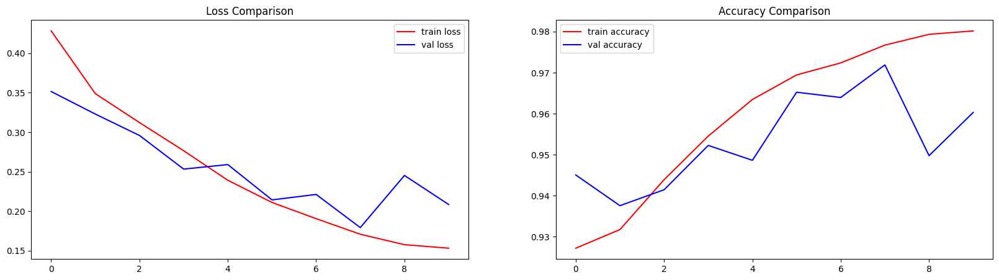

In [15]:
import matplotlib.pyplot as plt
fig, axis = plt.subplots(1, 2, figsize=(20, 5))
axis[0].plot(history1.history["loss"], color='r', label = 'train loss')
axis[0].plot(history1.history["val_loss"], color='b', label = 'val loss')
axis[0].set_title('Loss Comparison')
axis[0].legend()
axis[1].plot(history1.history["pixel_accuracy"], color='r', label = 'train accuracy')
axis[1].plot(history1.history["val_pixel_accuracy"], color='b', label = 'val accuracy')
axis[1].set_title('Accuracy Comparison')
axis[1].legend()

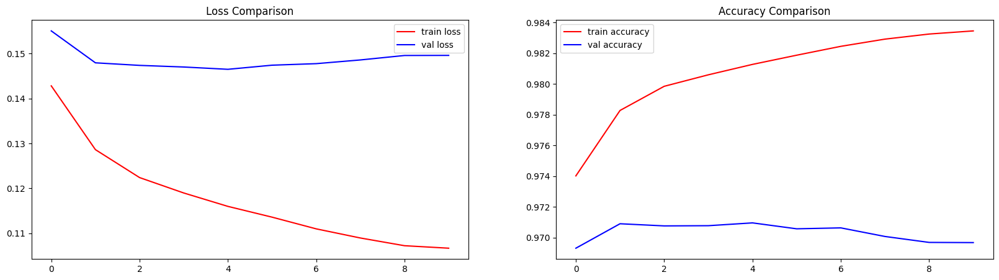

In [27]:
import matplotlib.pyplot as plt
fig, axis = plt.subplots(1, 2, figsize=(20, 5))
axis[0].plot(history2.history["loss"], color='r', label = 'train loss')
axis[0].plot(history2.history["val_loss"], color='b', label = 'val loss')
axis[0].set_title('Loss Comparison')
axis[0].legend()
axis[1].plot(history2.history["pixel_accuracy"], color='r', label = 'train accuracy')
axis[1].plot(history2.history["val_pixel_accuracy"], color='b', label = 'val accuracy')
axis[1].set_title('Accuracy Comparison')
axis[1].legend()

In [16]:
# Generate predictions for all images in the validation set
checkpoint_filepath = "deeplabv3_plus_segmentation.weights.h5"
model.load_weights(checkpoint_filepath)

# Generate predictions for all images in the validation set
val_dataset = get_dataset(
    batch_size, img_size, val_input_img_paths, val_target_img_paths
)
val_preds = model.predict(val_dataset)

22/22 ━━━━━━━━━━━━━━━━━━━━ 18s 577ms/step


In [28]:
# Generate predictions for all images in the validation set
val_dataset = get_dataset(
    batch_size, img_size, val_input_img_paths, val_target_img_paths
)
val_preds = model.predict(val_dataset)

22/22 ━━━━━━━━━━━━━━━━━━━━ 17s 542ms/step


In [29]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageOps

def visualize_predictions(val_input_img_paths, val_target_img_paths, val_preds, indices=None, alpha=0.5):
    """
    Visualize predictions in a grid: original, GT mask, predicted mask, overlay.

    Args:
        val_input_img_paths: list of input image file paths
        val_target_img_paths: list of ground truth mask file paths
        val_preds: model predictions (numpy array)
        indices: list of indices to visualize (if None, random sample of 4)
        alpha: overlay transparency for prediction
    """
    if indices is None:
        indices = np.random.choice(len(val_input_img_paths), size=4, replace=False)

    n = len(indices)
    fig, axs = plt.subplots(n, 4, figsize=(16, 4*n))

    if n == 1:
        axs = [axs]  # ensure iterable if only one row

    for row, i in enumerate(indices):
        # Load original image
        orig = np.array(Image.open(val_input_img_paths[i]))

        # Load GT mask
        gt_mask = np.array(Image.open(val_target_img_paths[i]))

        # Get predicted mask (argmax over channels)
        pred_mask = np.argmax(val_preds[i], axis=-1).astype(np.uint8)

        # Resize prediction to original image size
        pred_mask_resized = np.array(Image.fromarray(pred_mask).resize(orig.shape[1::-1], resample=Image.NEAREST))

        # Overlay prediction on original image
        overlay = orig.copy()
        overlay = (alpha * np.stack([pred_mask_resized]*3, axis=-1) * 50 + (1-alpha) * overlay).astype(np.uint8)

        # Plotting
        axs[row][0].imshow(orig)
        axs[row][0].set_title("Original")
        axs[row][0].axis("off")

        axs[row][1].imshow(gt_mask, cmap="gray")
        axs[row][1].set_title("GT Mask")
        axs[row][1].axis("off")

        axs[row][2].imshow(pred_mask_resized, cmap="gray")
        axs[row][2].set_title("Pred Mask")
        axs[row][2].axis("off")

        axs[row][3].imshow(orig)
        axs[row][3].imshow(pred_mask_resized, cmap="jet", alpha=alpha)  # transparent overlay
        axs[row][3].set_title("Overlay")
        axs[row][3].axis("off")

    plt.tight_layout()
    plt.show()

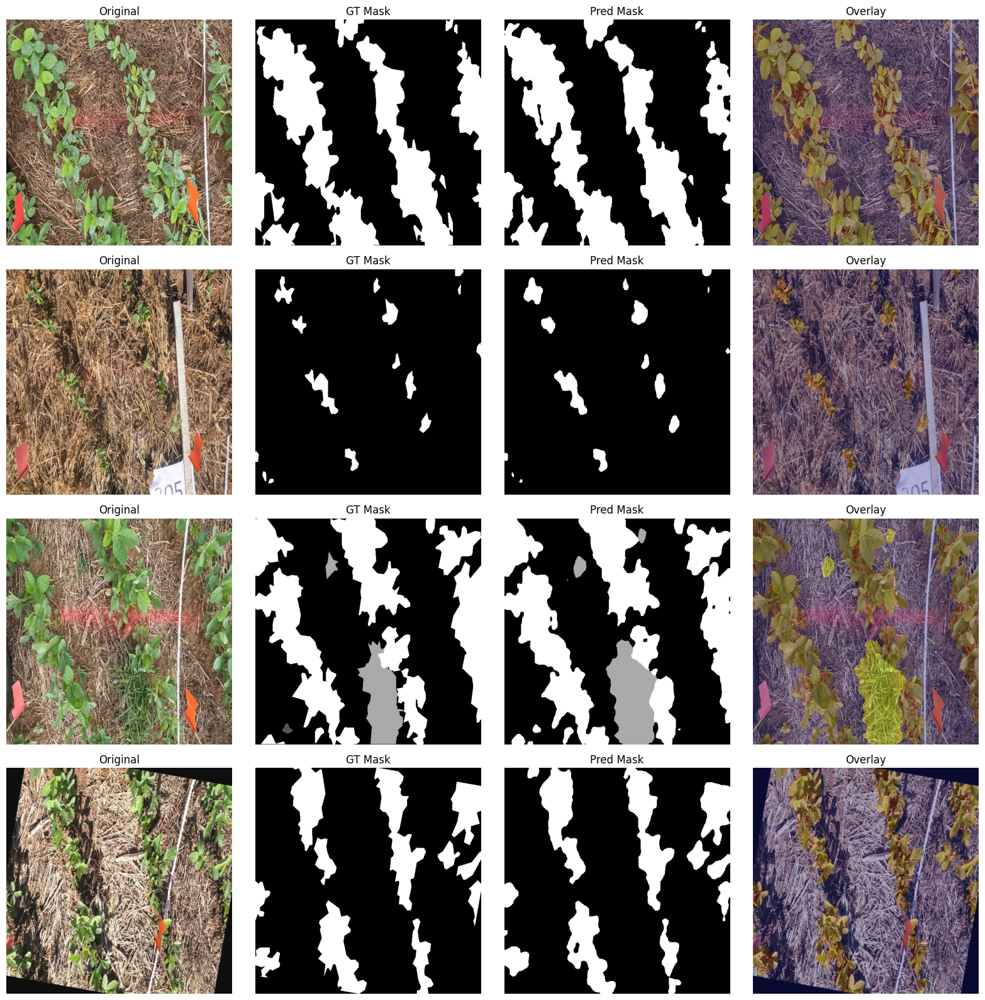

In [18]:
visualize_predictions(val_input_img_paths, val_target_img_paths, val_preds, indices=None, alpha=0.3)

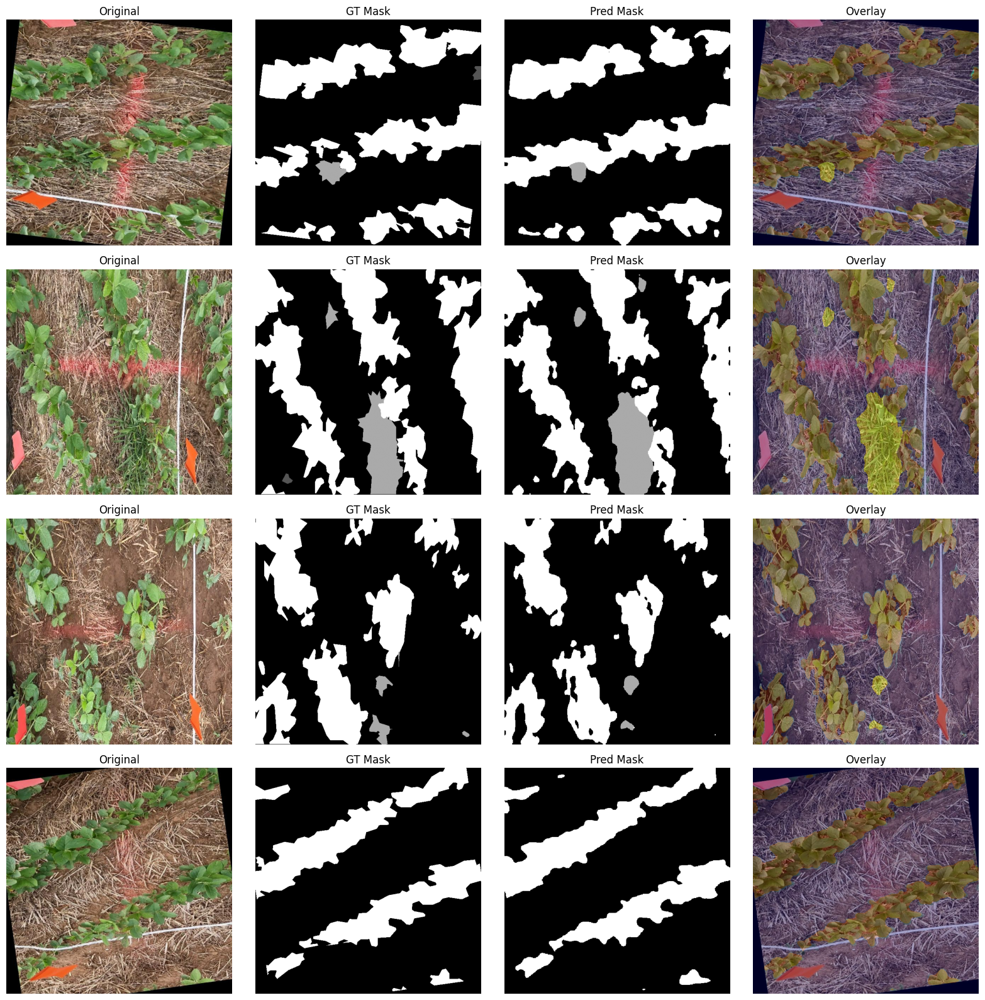

In [30]:
visualize_predictions(val_input_img_paths, val_target_img_paths, val_preds, indices=None, alpha=0.3)

In [31]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

CATEGORY_COLORS = {
    0: [255, 230, 153],    # background
    1: [255, 0, 127],      # broad_leaf_weed
    2: [255, 0, 255],      # grassy_weed
    3: [0, 255, 0],        # soy_plant
}

def decode_mask(mask, category_colors=CATEGORY_COLORS):
    """
    Convert class index mask -> RGB mask using category colors.
    """
    h, w = mask.shape
    rgb_mask = np.zeros((h, w, 3), dtype=np.uint8)
    for cls_id, color in category_colors.items():
        rgb_mask[mask == cls_id] = color
    return rgb_mask

def visualize_predictions(val_input_img_paths, val_target_img_paths, val_preds, indices=None, alpha=0.5):
    """
    Visualize predictions in a grid: original, GT mask, predicted mask, overlay.

    Args:
        val_input_img_paths: list of input image file paths
        val_target_img_paths: list of ground truth mask file paths
        val_preds: model predictions (numpy array)
        indices: list of indices to visualize (if None, random sample of 4)
        alpha: overlay transparency for prediction
    """
    if indices is None:
        indices = np.random.choice(len(val_input_img_paths), size=4, replace=False)

    n = len(indices)
    fig, axs = plt.subplots(n, 4, figsize=(16, 4*n))

    if n == 1:
        axs = [axs]

    for row, i in enumerate(indices):
        # Original image
        orig = np.array(Image.open(val_input_img_paths[i]))

        # GT mask
        gt_mask = np.array(Image.open(val_target_img_paths[i]))
        gt_mask_rgb = decode_mask(gt_mask)

        # Prediction
        pred_mask = np.argmax(val_preds[i], axis=-1).astype(np.uint8)
        pred_mask_resized = np.array(
            Image.fromarray(pred_mask).resize(orig.shape[1::-1], resample=Image.NEAREST)
        )
        pred_mask_rgb = decode_mask(pred_mask_resized)

        # Overlay
        overlay = ((1 - alpha) * orig + alpha * pred_mask_rgb).astype(np.uint8)

        # Plotting
        axs[row][0].imshow(orig)
        axs[row][0].set_title("Original")
        axs[row][0].axis("off")

        axs[row][1].imshow(gt_mask_rgb)
        axs[row][1].set_title("GT Mask")
        axs[row][1].axis("off")

        axs[row][2].imshow(pred_mask_rgb)
        axs[row][2].set_title("Pred Mask")
        axs[row][2].axis("off")

        axs[row][3].imshow(overlay)
        axs[row][3].set_title("Overlay")
        axs[row][3].axis("off")

    plt.tight_layout()
    plt.show()

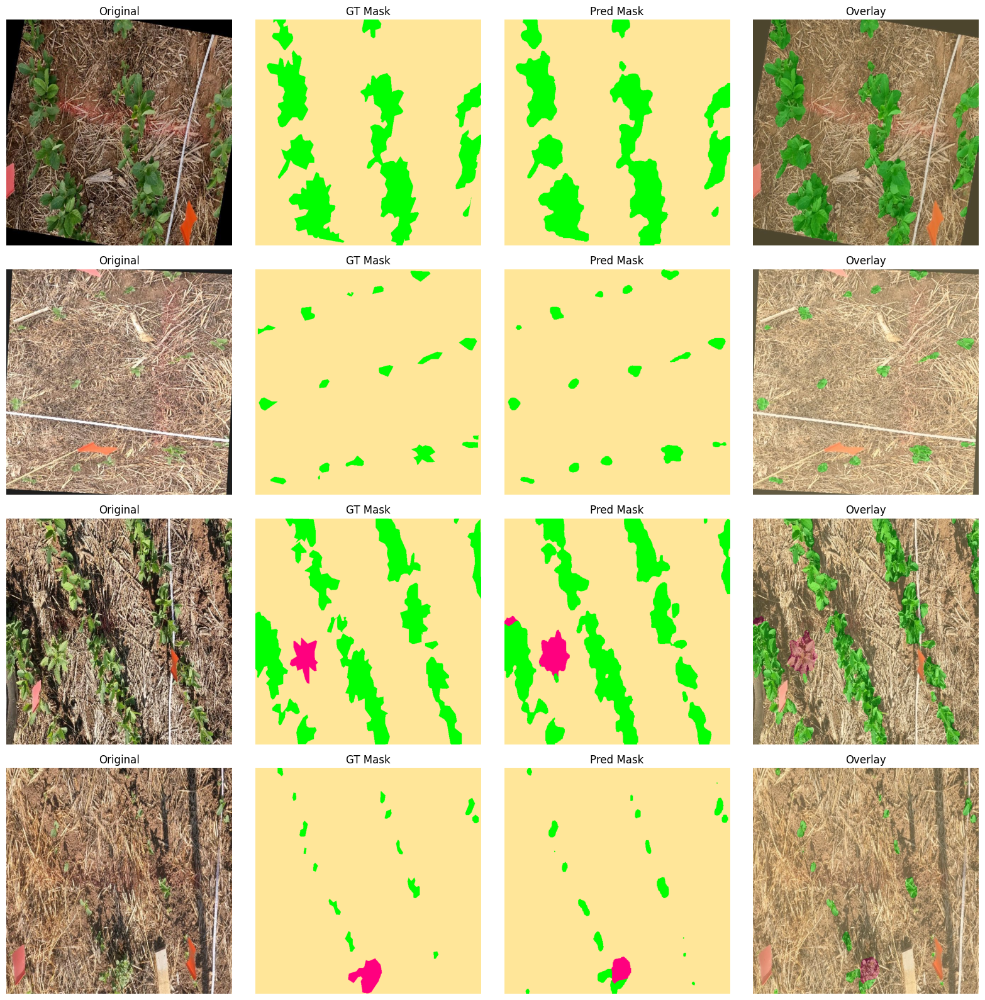

In [23]:
visualize_predictions(val_input_img_paths, val_target_img_paths, val_preds, indices=None, alpha=0.3)

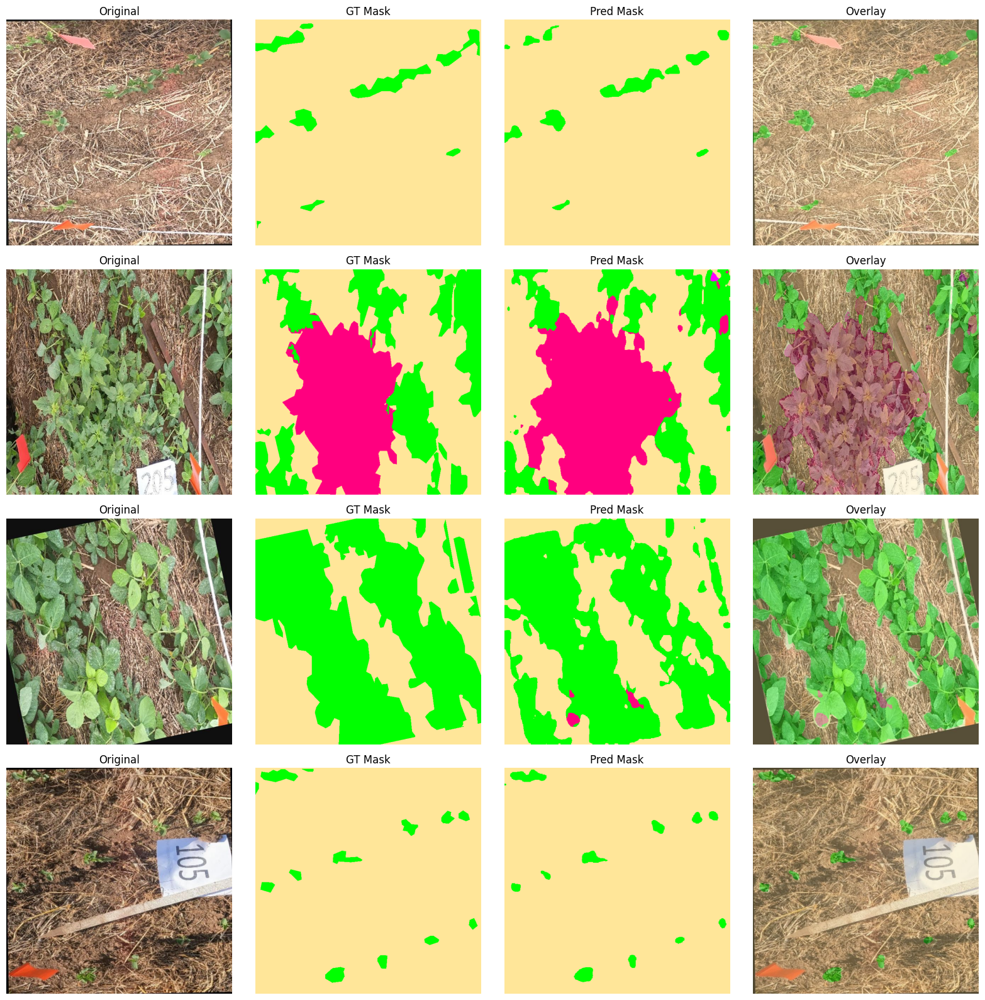

In [32]:
visualize_predictions(val_input_img_paths, val_target_img_paths, val_preds, indices=None, alpha=0.3)

In [33]:
# Serialize the model as a SavedModel.
# Use model.export for Keras models
model.export("deeplabv3_plus_segmentation")

import tensorflow as tf
# Convert to TFLite. This form of quantization is called
# post-training dynamic-range quantization in TFLite.
converter = tf.lite.TFLiteConverter.from_saved_model("deeplabv3_plus_segmentation")
converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.target_spec.supported_ops = [
    tf.lite.OpsSet.TFLITE_BUILTINS,  # Enable TensorFlow Lite ops.
    tf.lite.OpsSet.SELECT_TF_OPS,  # Enable TensorFlow ops.
]
tflite_model = converter.convert()
open("deeplabv3_plus_segmentation.tflite", "wb").write(tflite_model)

Saved artifact at 'deeplabv3_plus_segmentation'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 512, 512, 3), dtype=tf.float32, name='keras_tensor')
Output Type:
  TensorSpec(shape=(None, 512, 512, 4), dtype=tf.float32, name=None)
Captures:
  134258672541840: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672542608: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672543376: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672543568: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672534160: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672542800: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672544528: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672545872: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672547792: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134258672547984: TensorSpec(shape=(), dtype=tf.resource, name=N

18124416

In [35]:
import tensorflow as tf
import numpy as np
import random
import matplotlib.pyplot as plt
from PIL import Image

# Load TFLite model
interpreter = tf.lite.Interpreter(model_path="deeplabv3_plus_segmentation.tflite")
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

# Get input shape (batch, h, w, c)
input_shape = input_details[0]['shape'][1:3]

def preprocess_image(img_path, target_size):
    img = Image.open(img_path).convert("RGB").resize(target_size, Image.BILINEAR)
    arr = np.array(img, dtype=np.float32) #/ 255.0  # normalize if needed
    return arr

def run_tflite_inference(img_path):
    img = preprocess_image(img_path, tuple(input_shape))
    inp = np.expand_dims(img, axis=0)  # add batch dim

    # Run inference
    interpreter.set_tensor(input_details[0]['index'], inp)
    interpreter.invoke()
    output = interpreter.get_tensor(output_details[0]['index'])[0]

    # Convert to predicted mask
    pred_mask = np.argmax(output, axis=-1).astype(np.uint8)
    return pred_mask

def visualize_predictions_tflite(val_input_img_paths, val_target_img_paths, indices=None, alpha=0.5):
    if indices is None:
        indices = np.random.choice(len(val_input_img_paths), size=4, replace=False)

    n = len(indices)
    fig, axs = plt.subplots(n, 4, figsize=(16, 4*n))

    if n == 1:
        axs = [axs]

    for row, i in enumerate(indices):
        # Load original image
        orig = np.array(Image.open(val_input_img_paths[i]).convert("RGB"))

        # Load GT mask
        gt_mask = np.array(Image.open(val_target_img_paths[i]))

        # Run inference with TFLite
        pred_mask = run_tflite_inference(val_input_img_paths[i])

        # Resize predicted mask back to original image size
        pred_mask_resized = np.array(Image.fromarray(pred_mask).resize(orig.shape[1::-1], resample=Image.NEAREST))

        # Overlay
        axs[row][0].imshow(orig)
        axs[row][0].set_title("Original")
        axs[row][0].axis("off")

        axs[row][1].imshow(gt_mask, cmap="gray")
        axs[row][1].set_title("GT Mask")
        axs[row][1].axis("off")

        axs[row][2].imshow(pred_mask_resized, cmap="gray")
        axs[row][2].set_title("Pred Mask")
        axs[row][2].axis("off")

        axs[row][3].imshow(orig)
        axs[row][3].imshow(pred_mask_resized, cmap="jet", alpha=alpha)
        axs[row][3].set_title("Overlay")
        axs[row][3].axis("off")

    plt.tight_layout()
    plt.show()

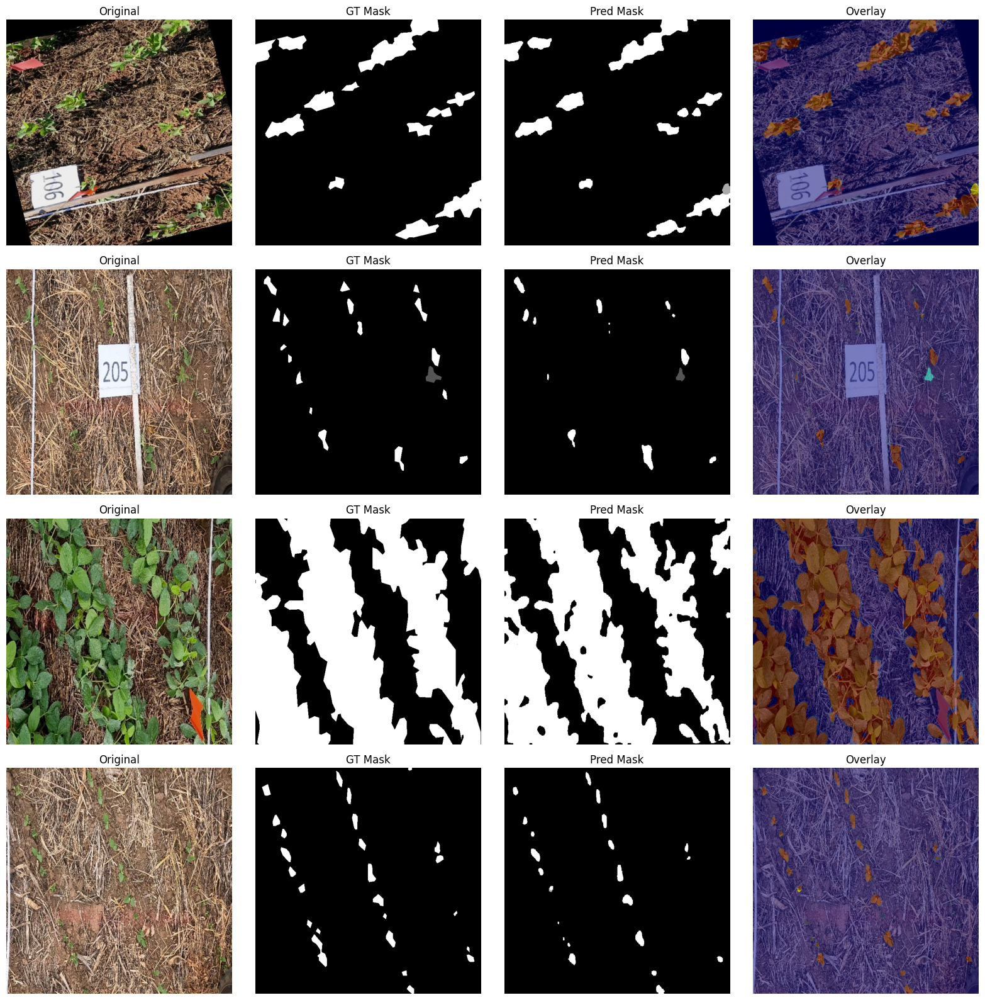

In [37]:
visualize_predictions_tflite(val_input_img_paths, val_target_img_paths, alpha=0.5)

In [38]:
import tensorflow as tf
import numpy as np
import random
import matplotlib.pyplot as plt
from PIL import Image

# Load TFLite model
interpreter = tf.lite.Interpreter(model_path="deeplabv3_plus_segmentation.tflite")
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

# Get input shape (batch, h, w, c)
input_shape = input_details[0]['shape'][1:3]

# Define category colors (R, G, B)
CATEGORY_COLORS = {
    0: [255, 230, 153],    # background
    1: [255, 0, 127],      # broad_leaf_weed
    2: [255, 0, 255],      # grassy_weed
    3: [0, 255, 0],        # soy_plant
}

def preprocess_image(img_path, target_size):
    img = Image.open(img_path).convert("RGB").resize(target_size, Image.BILINEAR)
    arr = np.array(img, dtype=np.float32)  # / 255.0  # normalize if needed
    return arr

def run_tflite_inference(img_path):
    img = preprocess_image(img_path, tuple(input_shape))
    inp = np.expand_dims(img, axis=0)  # add batch dim

    # Run inference
    interpreter.set_tensor(input_details[0]['index'], inp)
    interpreter.invoke()
    output = interpreter.get_tensor(output_details[0]['index'])[0]

    # Convert to predicted mask
    pred_mask = np.argmax(output, axis=-1).astype(np.uint8)
    return pred_mask

def decode_segmentation_mask(mask):
    """Map each label in mask to RGB color."""
    h, w = mask.shape
    color_mask = np.zeros((h, w, 3), dtype=np.uint8)
    for label, color in CATEGORY_COLORS.items():
        color_mask[mask == label] = color
    return color_mask

def visualize_predictions_tflite(val_input_img_paths, val_target_img_paths, indices=None, alpha=0.5):
    if indices is None:
        indices = np.random.choice(len(val_input_img_paths), size=4, replace=False)

    n = len(indices)
    fig, axs = plt.subplots(n, 4, figsize=(16, 4*n))

    if n == 1:
        axs = [axs]

    for row, i in enumerate(indices):
        # Load original image
        orig = np.array(Image.open(val_input_img_paths[i]).convert("RGB"))

        # Load GT mask
        gt_mask = np.array(Image.open(val_target_img_paths[i]))
        gt_color = decode_segmentation_mask(gt_mask)

        # Run inference with TFLite
        pred_mask = run_tflite_inference(val_input_img_paths[i])

        # Resize predicted mask back to original image size
        pred_mask_resized = np.array(
            Image.fromarray(pred_mask).resize(orig.shape[1::-1], resample=Image.NEAREST)
        )
        pred_color = decode_segmentation_mask(pred_mask_resized)

        # Overlay prediction on original image
        overlay = ((1 - alpha) * orig + alpha * pred_color).astype(np.uint8)

        # Plotting
        axs[row][0].imshow(orig)
        axs[row][0].set_title("Original")
        axs[row][0].axis("off")

        axs[row][1].imshow(gt_color)
        axs[row][1].set_title("GT Mask (Color)")
        axs[row][1].axis("off")

        axs[row][2].imshow(pred_color)
        axs[row][2].set_title("Pred Mask (Color)")
        axs[row][2].axis("off")

        axs[row][3].imshow(overlay)
        axs[row][3].set_title("Overlay")
        axs[row][3].axis("off")

    plt.tight_layout()
    plt.show()

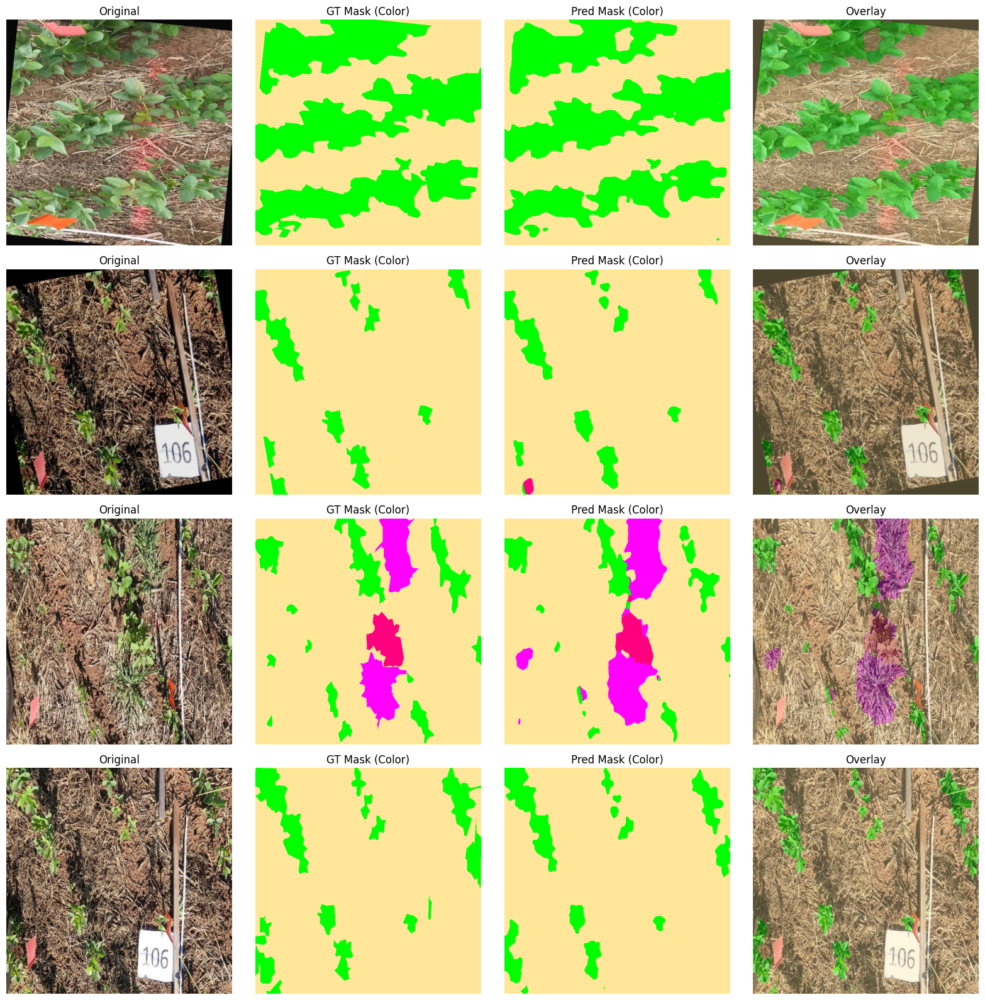

In [50]:
visualize_predictions_tflite(val_input_img_paths, val_target_img_paths, alpha=0.3)